<a href="https://colab.research.google.com/github/trevormoon/GAN_study/blob/main/image_style_transfer_test.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [44]:
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np

network = tf.keras.applications.VGG19(include_top=False, weights='imagenet')
network.summary()

Model: "vgg19"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_7 (InputLayer)        [(None, None, None, 3)]   0         
                                                                 
 block1_conv1 (Conv2D)       (None, None, None, 64)    1792      
                                                                 
 block1_conv2 (Conv2D)       (None, None, None, 64)    36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, None, None, 64)    0         
                                                                 
 block2_conv1 (Conv2D)       (None, None, None, 128)   73856     
                                                                 
 block2_conv2 (Conv2D)       (None, None, None, 128)   147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, None, None, 128)   0     

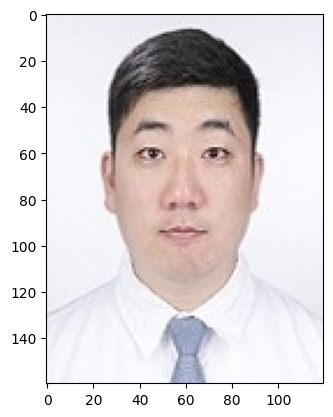

In [45]:
content_image_path = '/content/sample.jpg'
content_image = tf.keras.preprocessing.image.load_img(content_image_path)
plt.imshow(content_image);

In [46]:
type(content_image)

PIL.JpegImagePlugin.JpegImageFile

In [47]:
# Convert PIL image to numpy type to work with TensorFlow
content_image = tf.keras.preprocessing.image.img_to_array(content_image)

type(content_image), content_image.shape, content_image.min(), content_image.max()


(numpy.ndarray, (160, 120, 3), 1.0, 255.0)

In [48]:
# Normalizing
content_image = content_image / 255

content_image.min(), content_image.max()
content_image = content_image[tf.newaxis, :]
content_image.shape

(1, 160, 120, 3)

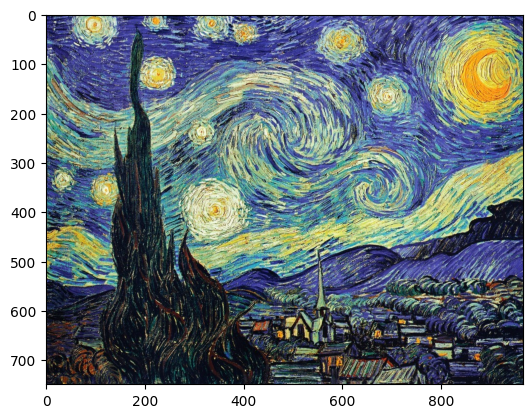

In [49]:
style_image_path = '/content/style.jpg'
style_image = tf.keras.preprocessing.image.load_img(style_image_path)

plt.imshow(style_image);

In [50]:
style_image = tf.keras.preprocessing.image.img_to_array(style_image)
style_image = style_image / 255
style_image = style_image[tf.newaxis, :]

style_image.shape

(1, 749, 966, 3)

In [51]:
content_layers = ['block4_conv2']
style_layers = ['block1_conv1', 'block2_conv1', 'block3_conv1', 'block4_conv1', 'block5_conv1']

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)
[network.get_layer(name).output for name in style_layers]

[<KerasTensor: shape=(None, None, None, 64) dtype=float32 (created by layer 'block1_conv1')>,
 <KerasTensor: shape=(None, None, None, 128) dtype=float32 (created by layer 'block2_conv1')>,
 <KerasTensor: shape=(None, None, None, 256) dtype=float32 (created by layer 'block3_conv1')>,
 <KerasTensor: shape=(None, None, None, 512) dtype=float32 (created by layer 'block4_conv1')>,
 <KerasTensor: shape=(None, None, None, 512) dtype=float32 (created by layer 'block5_conv1')>]

In [52]:
network.input

<KerasTensor: shape=(None, None, None, 3) dtype=float32 (created by layer 'input_7')>

In [53]:
def build_vgg_layers(layer_names):
    '''return output activation value'''
    vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')
    vgg.trainable = False

    outputs = [vgg.get_layer(name).output for name in layer_names]
    network = tf.keras.Model(inputs=[vgg.input], outputs=outputs)

    return network
# extract image style
style_extractor = build_vgg_layers(style_layers)

In [54]:
style_extractor.outputs

[<KerasTensor: shape=(None, None, None, 64) dtype=float32 (created by layer 'block1_conv1')>,
 <KerasTensor: shape=(None, None, None, 128) dtype=float32 (created by layer 'block2_conv1')>,
 <KerasTensor: shape=(None, None, None, 256) dtype=float32 (created by layer 'block3_conv1')>,
 <KerasTensor: shape=(None, None, None, 512) dtype=float32 (created by layer 'block4_conv1')>,
 <KerasTensor: shape=(None, None, None, 512) dtype=float32 (created by layer 'block5_conv1')>]

In [55]:
# 5 values with ReLU activation are applied
style_outputs = style_extractor(style_image)

style_outputs[0].shape, style_outputs[1].shape, style_outputs[2].shape, style_outputs[3].shape, style_outputs[4].shape

(TensorShape([1, 749, 966, 64]),
 TensorShape([1, 374, 483, 128]),
 TensorShape([1, 187, 241, 256]),
 TensorShape([1, 93, 120, 512]),
 TensorShape([1, 46, 60, 512]))

In [56]:
# https://www.tensorflow.org/api_docs/python/tf/einsum

# Loss between the style and the content image (see original paper, section 2.2)
def gram_matrix(layer_activation):
    result = tf.linalg.einsum('bijc,bijd->bcd', layer_activation, layer_activation)
    input_shape = tf.shape(layer_activation)
    num_locations = tf.cast(input_shape[1] * input_shape[2], tf.float32)

    return result / num_locations  # Normalizing


In [57]:
class StyleContentModel(tf.keras.models.Model):
    '''Build a model that returns the style and content tensors.'''
    def __init__(self, style_layers, content_layers):
        super().__init__()
        self.vgg = build_vgg_layers(style_layers + content_layers)
        self.style_layers = style_layers
        self.content_layers = content_layers
        self.num_style_layers = len(style_layers)
        self.vgg.trainable = False  # Because this network won't be trained

    def call(self, inputs):
        inputs = inputs * 255.0  # Denormalizing (Expects float input in [0,1])
        # Data is preprocessed and passed to the VGG (normalized from -127.50 to +127.50)
        preprocessed_input = tf.keras.applications.vgg19.preprocess_input(inputs)
        outputs = self.vgg(preprocessed_input)
        style_outputs = outputs[:self.num_style_layers]
        content_outputs = outputs[self.num_style_layers:]

        style_outputs = [gram_matrix(style_output) for style_output in style_outputs]

        content_dict = {content_name: value for content_name, value in zip(self.content_layers, content_outputs)}
        style_dict = {style_name: value for style_name, value in zip(self.style_layers, style_outputs)}

        return {'content': content_dict, 'style': style_dict}

In [58]:
extractor = StyleContentModel(style_layers, content_layers)

In [59]:
results = extractor(content_image)

In [60]:
for key, value in results.items():
    print(key, value.keys())

content dict_keys(['block4_conv2'])
style dict_keys(['block1_conv1', 'block2_conv1', 'block3_conv1', 'block4_conv1', 'block5_conv1'])


In [61]:
style_targets = extractor(style_image)['style']
content_targets = extractor(content_image)['content']

Epoch 25 | content loss: 533517248.0 | style loss: 307329216.0 | total loss 840846464.0


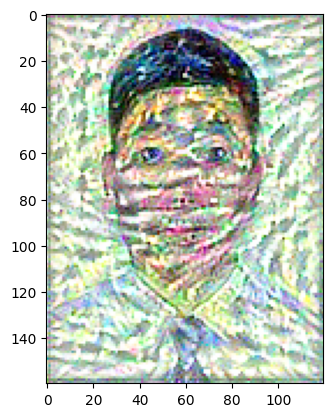

Epoch 50 | content loss: 449110272.0 | style loss: 195716976.0 | total loss 644827264.0


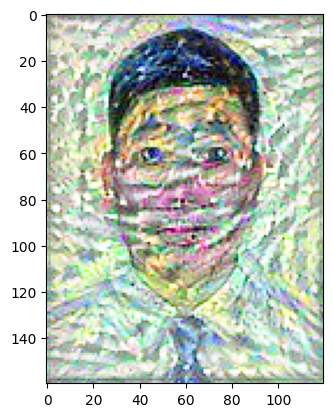

Epoch 75 | content loss: 418306176.0 | style loss: 168533024.0 | total loss 586839168.0


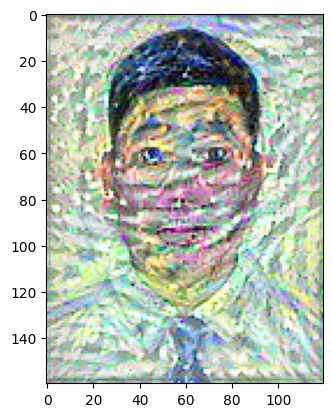

Epoch 100 | content loss: 406423552.0 | style loss: 156916144.0 | total loss 563339712.0


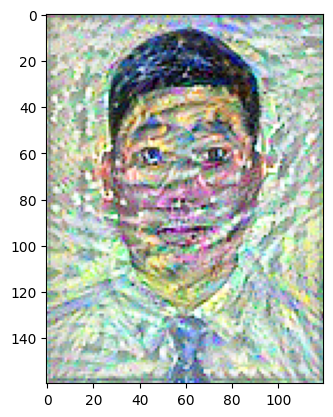

Epoch 125 | content loss: 398904608.0 | style loss: 150082592.0 | total loss 548987200.0


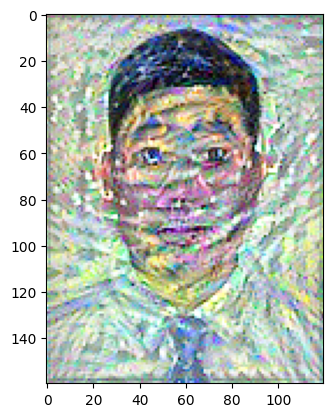

Epoch 150 | content loss: 394430464.0 | style loss: 147826032.0 | total loss 542256512.0


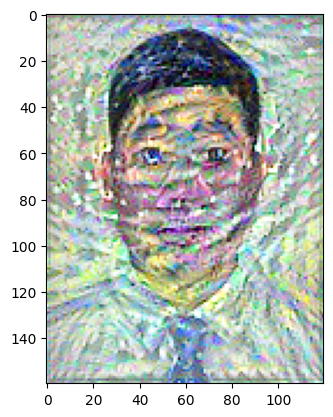

Epoch 175 | content loss: 389864576.0 | style loss: 144018960.0 | total loss 533883520.0


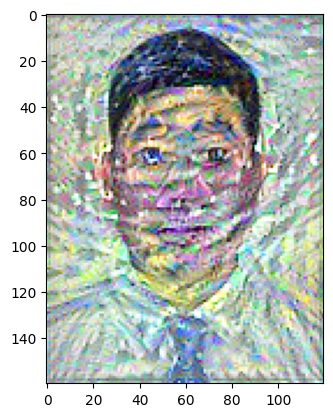

Epoch 200 | content loss: 387391744.0 | style loss: 150336512.0 | total loss 537728256.0


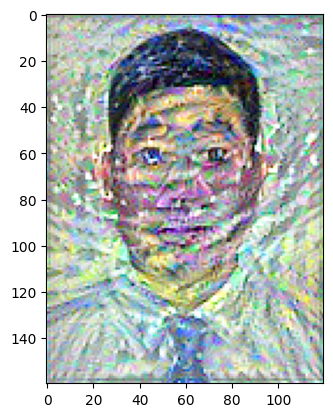

Epoch 225 | content loss: 385808064.0 | style loss: 161875008.0 | total loss 547683072.0


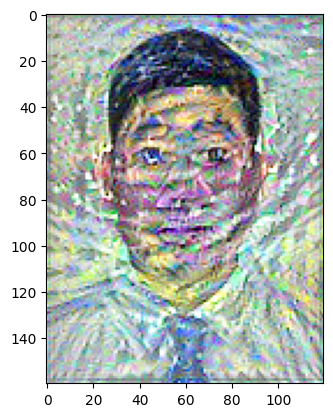

Epoch 250 | content loss: 378181312.0 | style loss: 151868336.0 | total loss 530049664.0


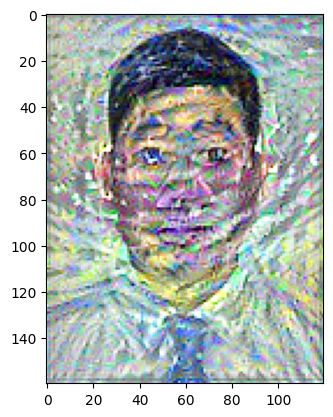

Epoch 275 | content loss: 382844544.0 | style loss: 138330496.0 | total loss 521175040.0


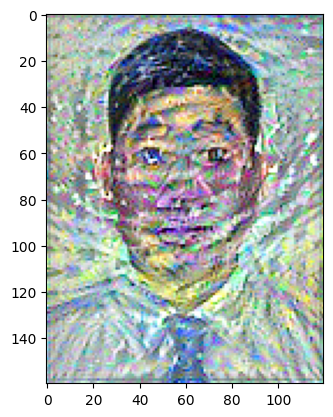

Epoch 300 | content loss: 379791904.0 | style loss: 136571744.0 | total loss 516363648.0


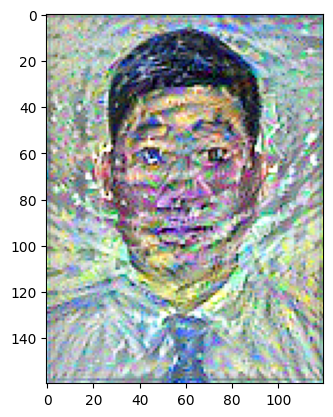

Epoch 325 | content loss: 380523040.0 | style loss: 138117776.0 | total loss 518640832.0


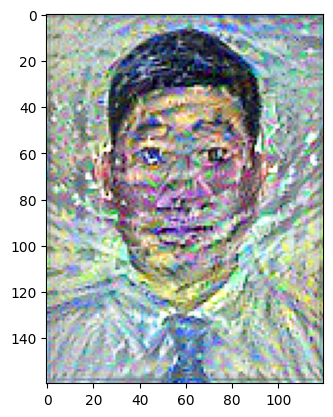

Epoch 350 | content loss: 374714624.0 | style loss: 141440176.0 | total loss 516154816.0


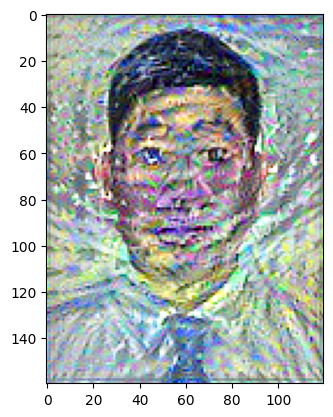

Epoch 375 | content loss: 379899008.0 | style loss: 195200064.0 | total loss 575099072.0


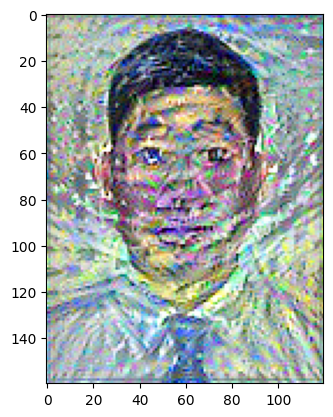

Epoch 400 | content loss: 380478464.0 | style loss: 139233488.0 | total loss 519711936.0


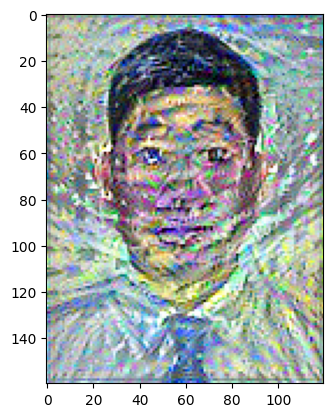

Epoch 425 | content loss: 371845536.0 | style loss: 137646208.0 | total loss 509491744.0


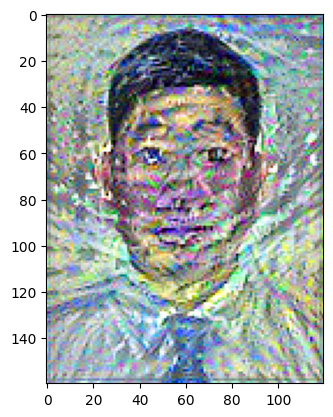

Epoch 450 | content loss: 379870784.0 | style loss: 177970720.0 | total loss 557841536.0


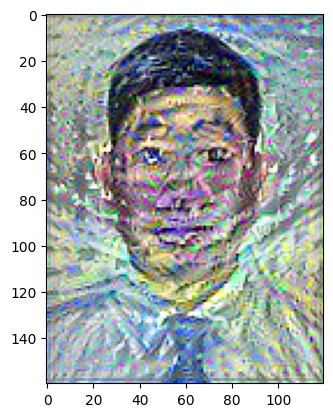

Epoch 475 | content loss: 376707584.0 | style loss: 136639872.0 | total loss 513347456.0


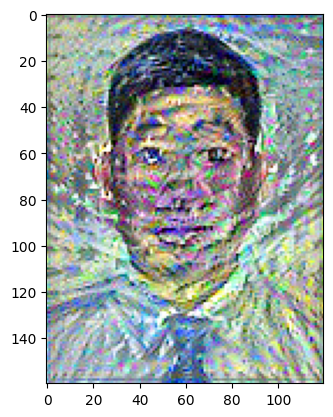

Epoch 500 | content loss: 377152992.0 | style loss: 137129792.0 | total loss 514282784.0


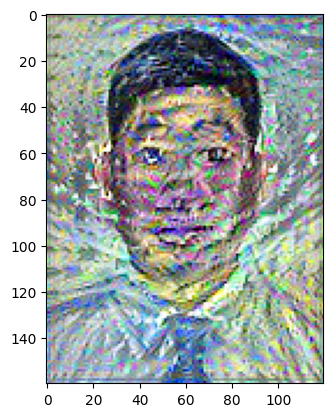

Epoch 525 | content loss: 371982592.0 | style loss: 136397376.0 | total loss 508379968.0


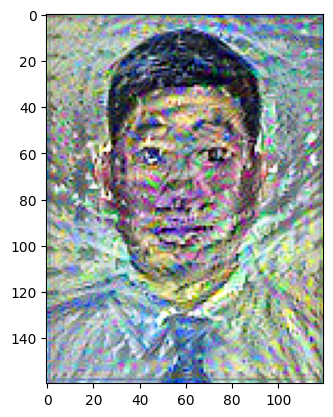

Epoch 550 | content loss: 371935840.0 | style loss: 142287616.0 | total loss 514223456.0


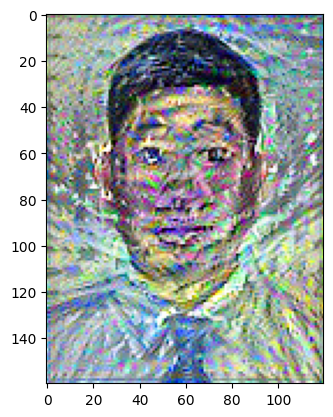

Epoch 575 | content loss: 370647264.0 | style loss: 144682032.0 | total loss 515329280.0


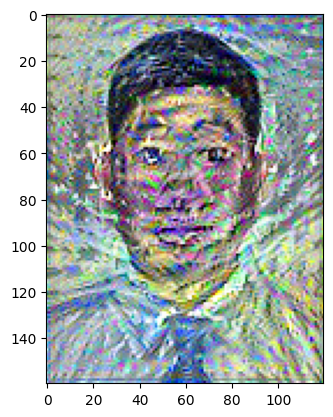

Epoch 600 | content loss: 369367328.0 | style loss: 140678368.0 | total loss 510045696.0


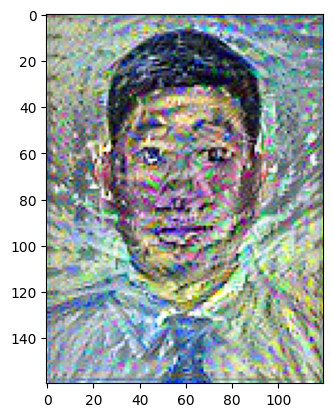

Epoch 625 | content loss: 372427168.0 | style loss: 143028832.0 | total loss 515456000.0


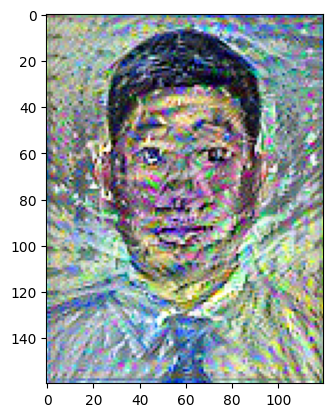

Epoch 650 | content loss: 370202560.0 | style loss: 129840840.0 | total loss 500043392.0


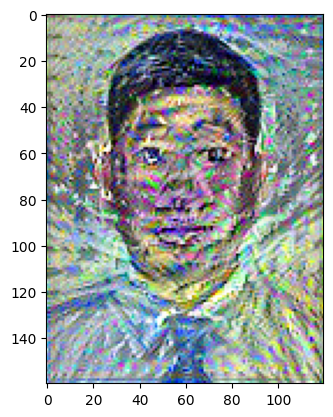

Epoch 675 | content loss: 367932640.0 | style loss: 152582176.0 | total loss 520514816.0


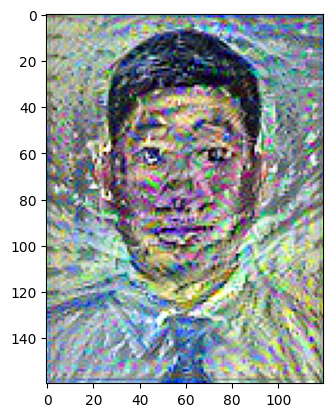

Epoch 700 | content loss: 371858560.0 | style loss: 128923064.0 | total loss 500781632.0


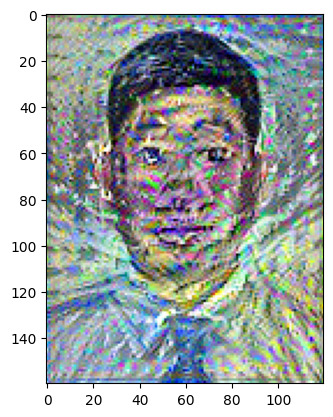

Epoch 725 | content loss: 379361440.0 | style loss: 162534064.0 | total loss 541895488.0


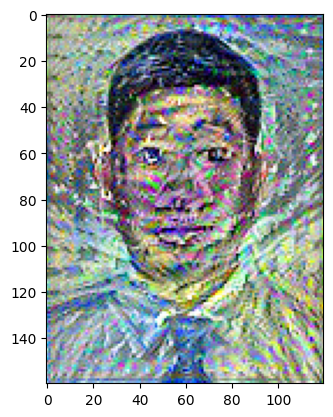

Epoch 750 | content loss: 406599904.0 | style loss: 178418032.0 | total loss 585017920.0


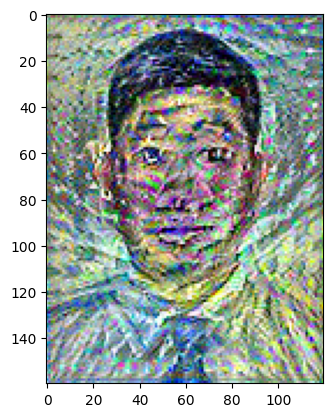

Epoch 775 | content loss: 386050848.0 | style loss: 169745840.0 | total loss 555796672.0


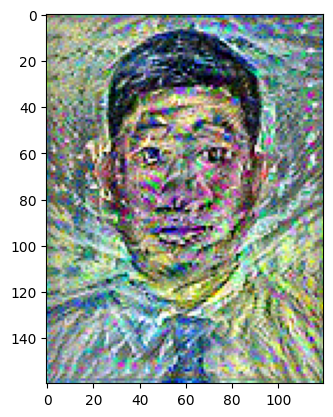

Epoch 800 | content loss: 375028736.0 | style loss: 136360448.0 | total loss 511389184.0


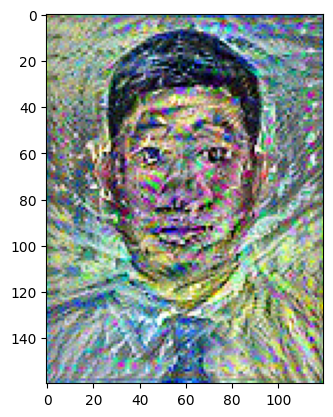

Epoch 825 | content loss: 378556864.0 | style loss: 131136200.0 | total loss 509693056.0


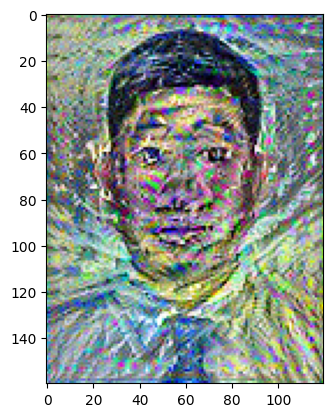

Epoch 850 | content loss: 371290016.0 | style loss: 128271728.0 | total loss 499561728.0


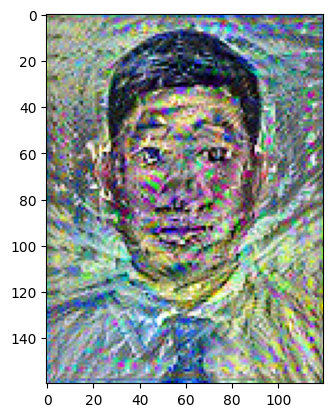

Epoch 875 | content loss: 370430240.0 | style loss: 126929232.0 | total loss 497359488.0


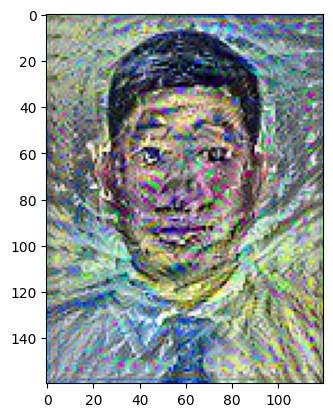

Epoch 900 | content loss: 366463360.0 | style loss: 142599904.0 | total loss 509063264.0


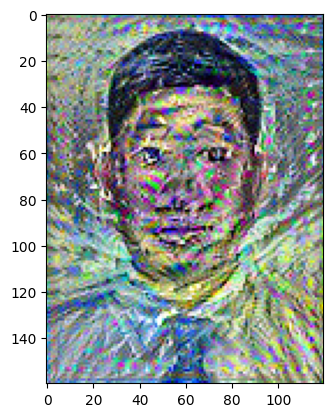

Epoch 925 | content loss: 377530912.0 | style loss: 166153408.0 | total loss 543684352.0


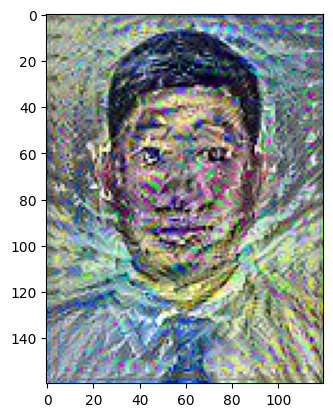

Epoch 950 | content loss: 370294560.0 | style loss: 125518432.0 | total loss 495812992.0


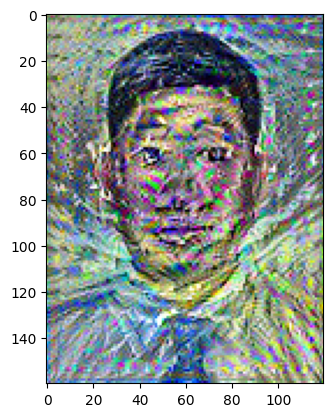

Epoch 975 | content loss: 369264896.0 | style loss: 126785752.0 | total loss 496050656.0


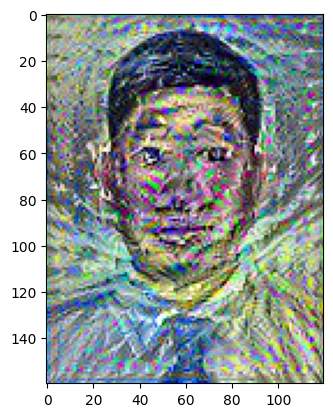

Epoch 1000 | content loss: 372417696.0 | style loss: 126921952.0 | total loss 499339648.0


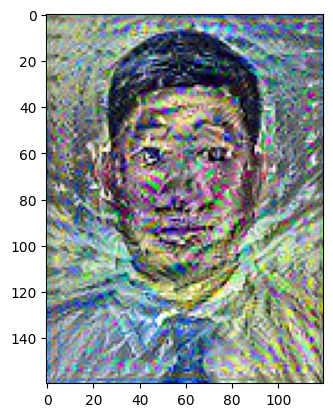

Epoch 1025 | content loss: 367078400.0 | style loss: 129450696.0 | total loss 496529088.0


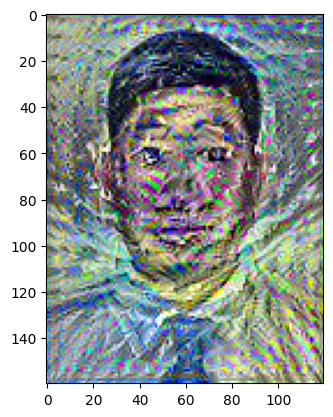

Epoch 1050 | content loss: 371694176.0 | style loss: 128353592.0 | total loss 500047776.0


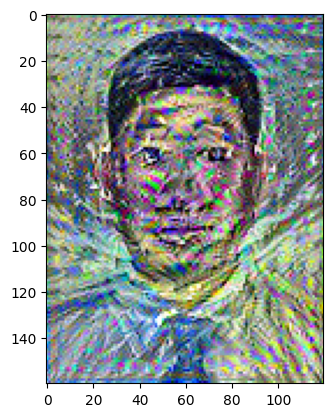

Epoch 1075 | content loss: 364178656.0 | style loss: 134827728.0 | total loss 499006400.0


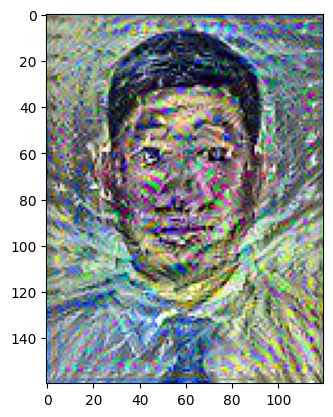

Epoch 1100 | content loss: 375227520.0 | style loss: 164062080.0 | total loss 539289600.0


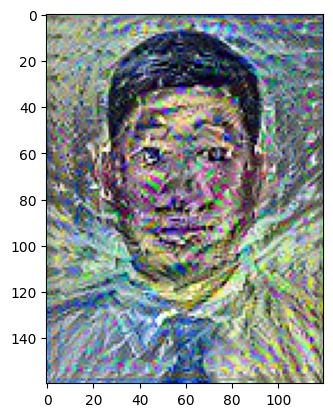

Epoch 1125 | content loss: 459742336.0 | style loss: 379756256.0 | total loss 839498624.0


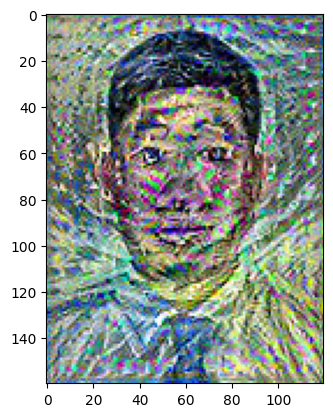

Epoch 1150 | content loss: 435792128.0 | style loss: 276256608.0 | total loss 712048768.0


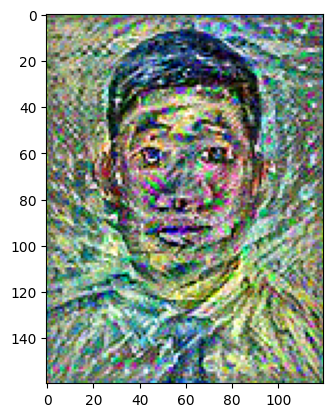

Epoch 1175 | content loss: 407881312.0 | style loss: 204122944.0 | total loss 612004224.0


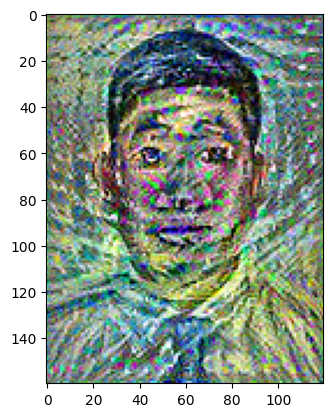

Epoch 1200 | content loss: 385885440.0 | style loss: 139497872.0 | total loss 525383296.0


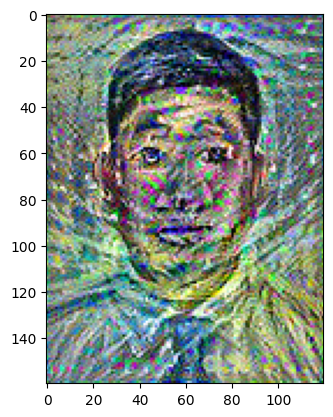

Epoch 1225 | content loss: 374188864.0 | style loss: 145101568.0 | total loss 519290432.0


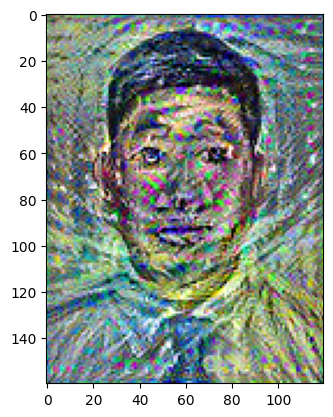

Epoch 1250 | content loss: 371412480.0 | style loss: 131180344.0 | total loss 502592832.0


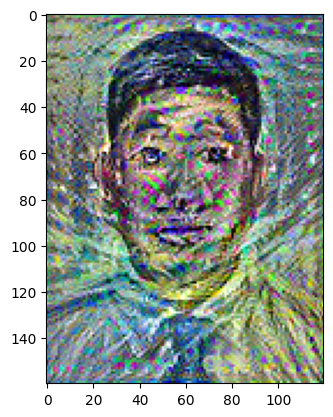

Epoch 1275 | content loss: 373894560.0 | style loss: 133691808.0 | total loss 507586368.0


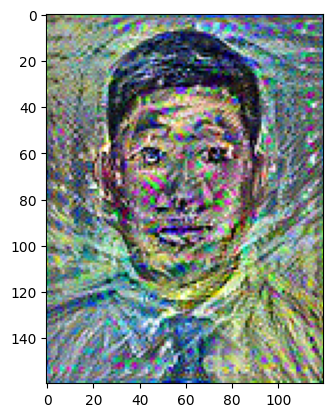

Epoch 1300 | content loss: 372976768.0 | style loss: 125030704.0 | total loss 498007488.0


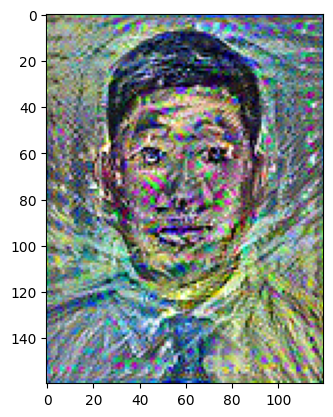

Epoch 1325 | content loss: 372660160.0 | style loss: 124528768.0 | total loss 497188928.0


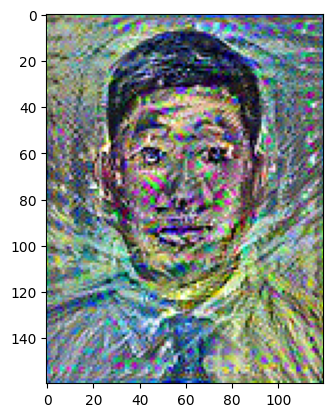

Epoch 1350 | content loss: 376840608.0 | style loss: 131857296.0 | total loss 508697920.0


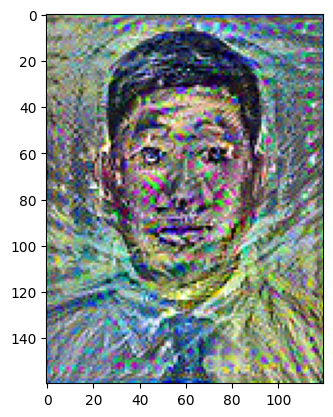

Epoch 1375 | content loss: 373474464.0 | style loss: 146214256.0 | total loss 519688704.0


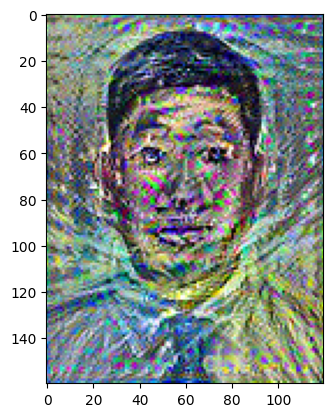

Epoch 1400 | content loss: 370850944.0 | style loss: 124150912.0 | total loss 495001856.0


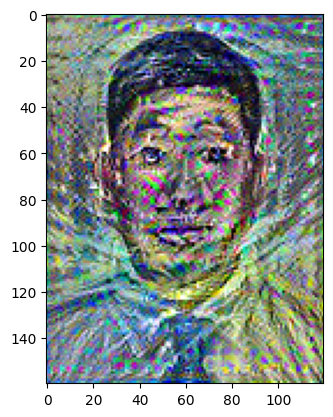

Epoch 1425 | content loss: 368411680.0 | style loss: 124472744.0 | total loss 492884416.0


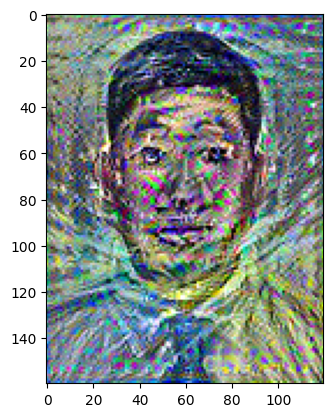

Epoch 1450 | content loss: 364791264.0 | style loss: 131319832.0 | total loss 496111104.0


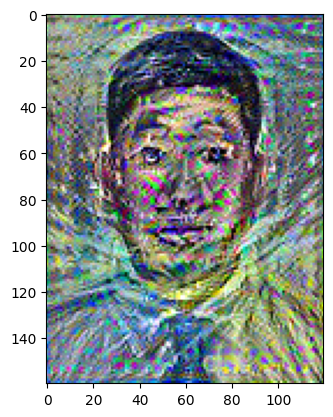

Epoch 1475 | content loss: 365213184.0 | style loss: 131721432.0 | total loss 496934624.0


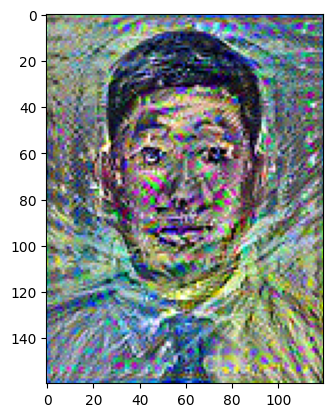

Epoch 1500 | content loss: 371451616.0 | style loss: 128573784.0 | total loss 500025408.0


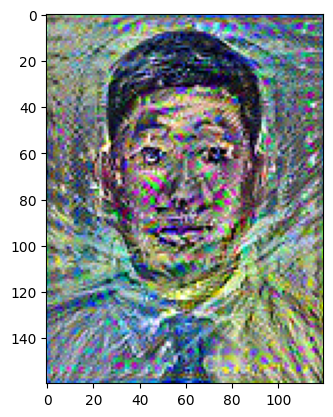

Epoch 1525 | content loss: 373459360.0 | style loss: 126525312.0 | total loss 499984672.0


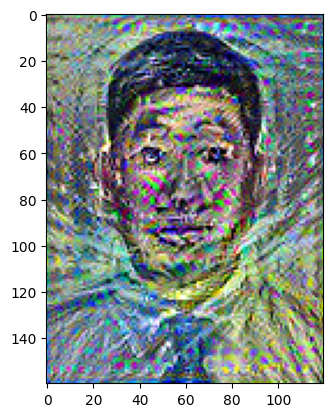

Epoch 1550 | content loss: 367112480.0 | style loss: 130056520.0 | total loss 497168992.0


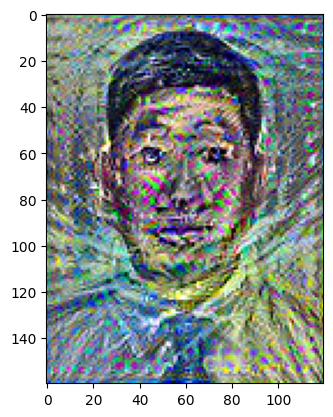

Epoch 1575 | content loss: 368942624.0 | style loss: 123981464.0 | total loss 492924096.0


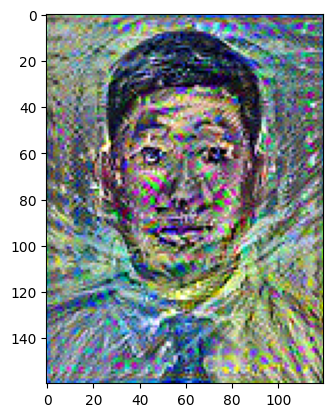

Epoch 1600 | content loss: 369322624.0 | style loss: 126446192.0 | total loss 495768832.0


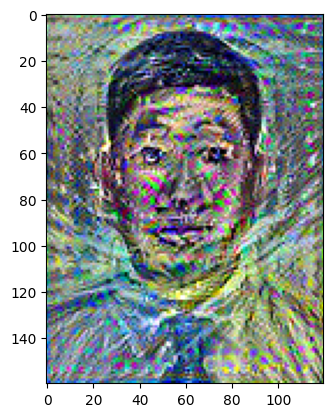

Epoch 1625 | content loss: 374769728.0 | style loss: 143056976.0 | total loss 517826688.0


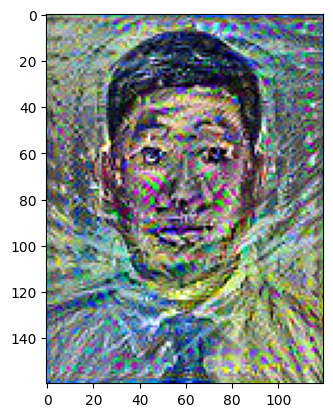

Epoch 1650 | content loss: 380997120.0 | style loss: 175663456.0 | total loss 556660608.0


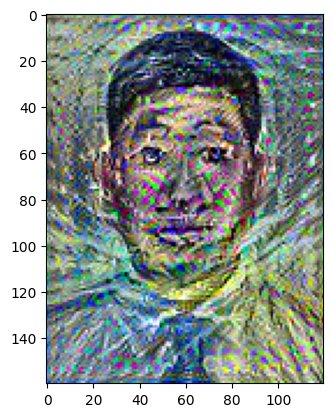

Epoch 1675 | content loss: 372701536.0 | style loss: 182358416.0 | total loss 555059968.0


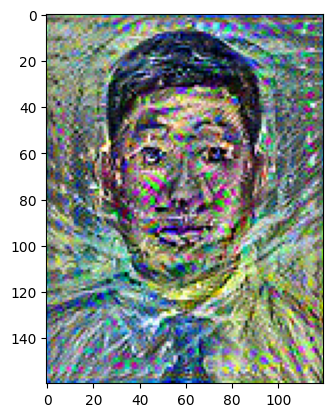

Epoch 1700 | content loss: 371699520.0 | style loss: 129604984.0 | total loss 501304512.0


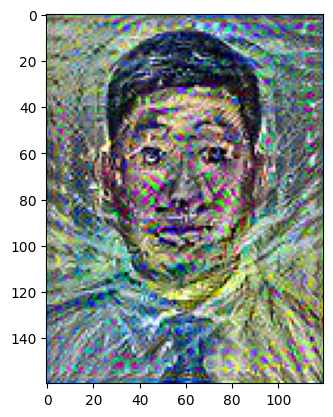

Epoch 1725 | content loss: 368182656.0 | style loss: 125131080.0 | total loss 493313728.0


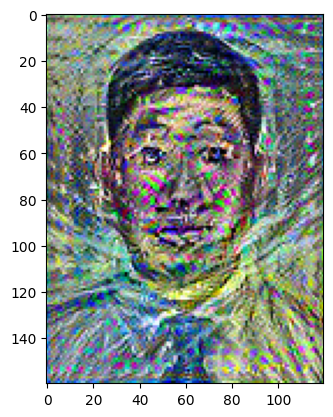

Epoch 1750 | content loss: 374922368.0 | style loss: 128640472.0 | total loss 503562848.0


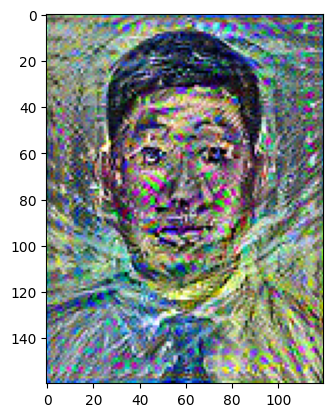

Epoch 1775 | content loss: 369490816.0 | style loss: 128721120.0 | total loss 498211936.0


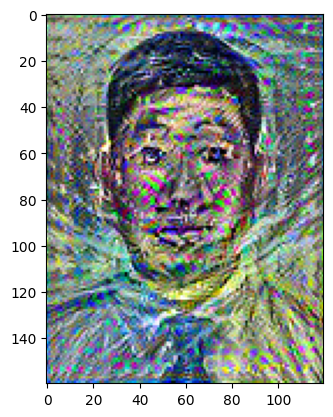

Epoch 1800 | content loss: 367324288.0 | style loss: 121542256.0 | total loss 488866560.0


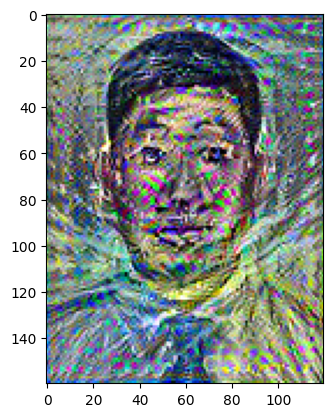

Epoch 1825 | content loss: 369784640.0 | style loss: 124255432.0 | total loss 494040064.0


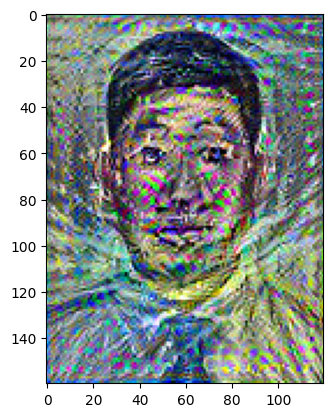

Epoch 1850 | content loss: 361000480.0 | style loss: 146688896.0 | total loss 507689376.0


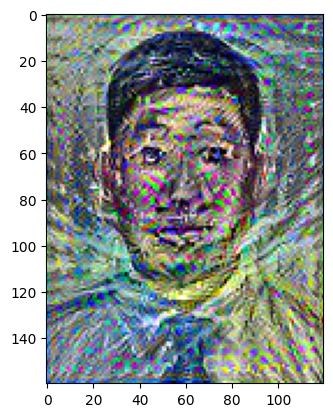

Epoch 1875 | content loss: 363937184.0 | style loss: 130683584.0 | total loss 494620768.0


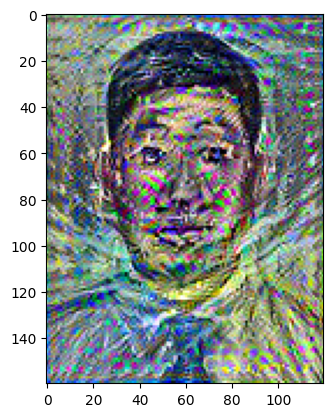

Epoch 1900 | content loss: 362702624.0 | style loss: 128518344.0 | total loss 491220960.0


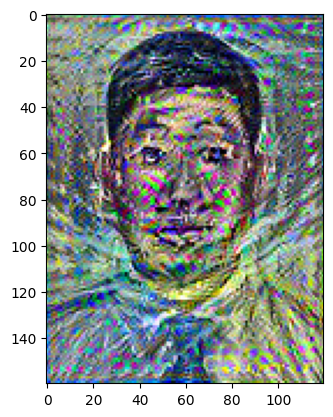

Epoch 1925 | content loss: 377954016.0 | style loss: 160715744.0 | total loss 538669760.0


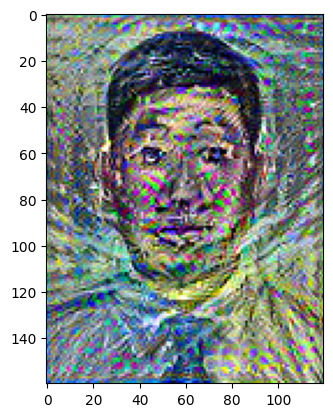

Epoch 1950 | content loss: 361034240.0 | style loss: 200233424.0 | total loss 561267648.0


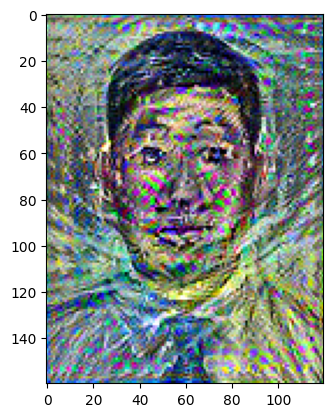

Epoch 1975 | content loss: 388562080.0 | style loss: 166250096.0 | total loss 554812160.0


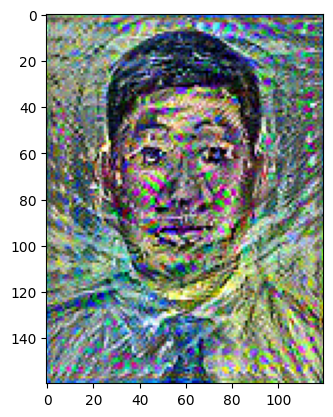

Epoch 2000 | content loss: 370146944.0 | style loss: 136805632.0 | total loss 506952576.0


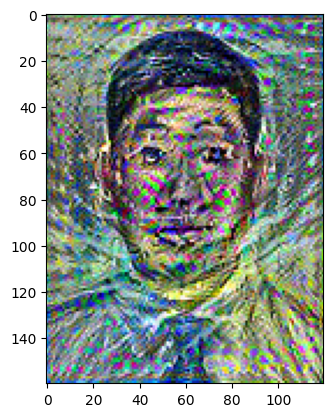

In [64]:
new_image = tf.Variable(content_image)
optimizer = tf.optimizers.Adam(learning_rate=0.07)

content_weight = 1e3  # The greater the content weight, the greater the retention of the original image content
style_weight = 1e-1  # The greater the style weight, the more styles are preserved

num_epochs = 2000
verbose = 25

for epoch in range(num_epochs):
    with tf.GradientTape() as tape:
        outputs = extractor(new_image)

        content_outputs = outputs['content']
        style_outputs = outputs['style']

        content_loss = tf.add_n([tf.reduce_mean((content_outputs[name] - content_targets[name]) ** 2) for name in content_outputs.keys()])
        content_loss *= content_weight / num_content_layers

        style_loss = tf.add_n([tf.reduce_mean((style_outputs[name] - style_targets[name]) ** 2) for name in style_outputs.keys()])
        style_loss *= style_weight / num_style_layers

        total_loss = content_loss + style_loss

    gradient = tape.gradient(total_loss, new_image)
    optimizer.apply_gradients([(gradient, new_image)])

    new_image.assign(tf.clip_by_value(new_image, 0.0, 1.0))

    if (epoch + 1) % verbose == 0:
        print(f'Epoch {epoch + 1} | content loss: {content_loss} | style loss: {style_loss} | total loss {total_loss}')
        plt.imshow(tf.squeeze(new_image, axis=0))
        plt.show()

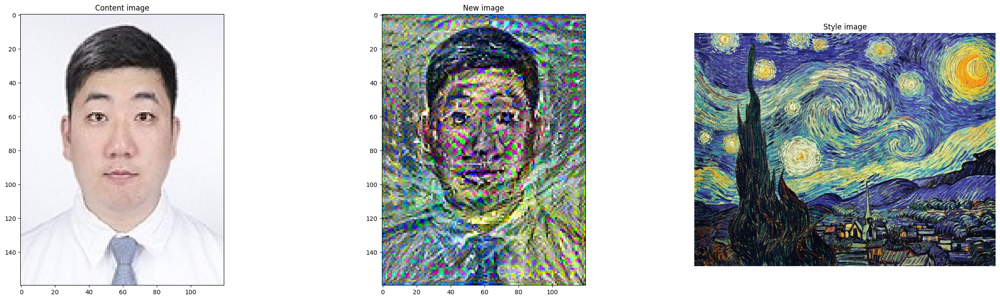

In [65]:
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 8))
ax1.imshow(tf.squeeze(content_image, axis=0))
ax1.set_title('Content image')
ax2.imshow(tf.squeeze(new_image, axis=0))
ax2.set_title('New image')
ax3.imshow(tf.squeeze(style_image, axis=0))
ax3.set_title('Style image')
plt.axis('off');

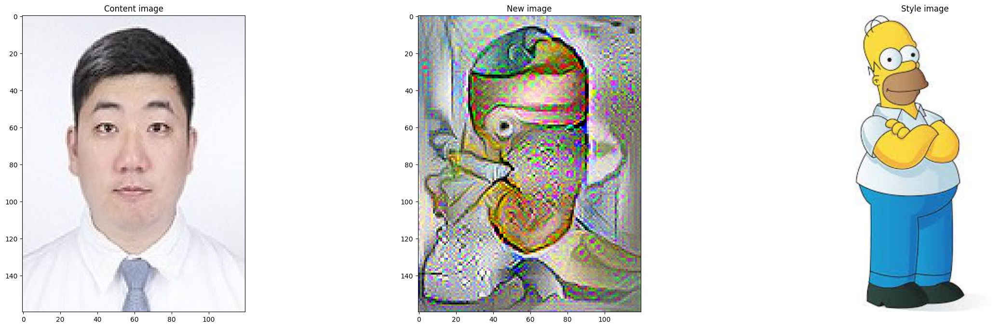

In [42]:
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 8))
ax1.imshow(tf.squeeze(content_image, axis=0))
ax1.set_title('Content image')
ax2.imshow(tf.squeeze(new_image, axis=0))
ax2.set_title('New image')
ax3.imshow(tf.squeeze(style_image, axis=0))
ax3.set_title('Style image')
plt.axis('off');